# Face Generation 2nd attempt
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
#data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

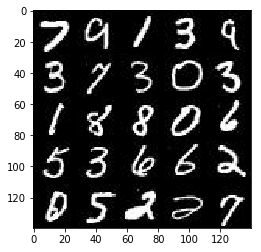

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

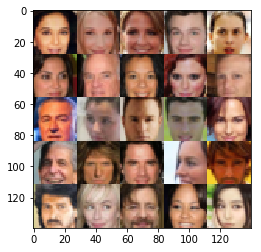

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # COMPLETED: Implement Function
    inputs_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='inputs_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name="input_z")
    learning_rate = tf.placeholder(tf.float32, name="learning_rate")
    
    return inputs_real, inputs_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the generator, tensor logits of the generator).

In [6]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # COMPLETED: Implement Function
    
    # Add alpha (normally present in the arguments)
    alpha = 0.1
    
    with tf.variable_scope('discriminator', reuse=reuse):
        # First hidden layer
        h1 = tf.layers.conv2d(images,
                             64,
                             5,
                             strides=2,
                             padding="same")
        relu1 = tf.maximum(alpha * h1, h1)
        
        # Second hidden layer
        h2 = tf.layers.conv2d(relu1,
                             128,
                             5,
                             strides=1,
                             padding="same")
        batch_norm2 = tf.layers.batch_normalization(h2,
                                                   training=True)
        relu2 = tf.maximum(alpha * batch_norm2, batch_norm2)
        
        # Third hidden layer
        h3 = tf.layers.conv2d(relu2,
                             256,
                             5,
                             strides=2,
                             padding="same")
        batch_norm3 = tf.layers.batch_normalization(h3,
                                                   training=True)
        relu3 = tf.maximum(alpha * batch_norm3, batch_norm3)
        
        # Flatten it
        flat = tf.reshape(relu3, (-1, 7*7*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)

    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    
    alpha = 0.2
    
    # This generator follow the main scheme of the DCGAN exercise
    # COMPLETED: Implement Function
    with tf.variable_scope("generator", reuse=not is_train):
        # First fully connected layer
        h1 = tf.layers.dense(z,
                            7*7*512)
        
        # Reshape
        h1 = tf.reshape(h1, (-1, 7, 7, 512))
        batch_norm1 = tf.layers.batch_normalization(h1, 
                                                    training=is_train)
        relu1 = tf.maximum(alpha * batch_norm1, 
                           batch_norm1)
        
        # Hidden layer 2
        h2 = tf.layers.conv2d_transpose(relu1, 
                                        256, 
                                        5, 
                                        strides=1, 
                                        padding="same")
        batch_norm2 = tf.layers.batch_normalization(h2, 
                                                    training=is_train)
        relu2 = tf.maximum(alpha * batch_norm2, 
                           batch_norm2)
        
        # Hidden layer 3
        h3 = tf.layers.conv2d_transpose(relu2, 
                                        128, 
                                        5, 
                                        strides=2, 
                                        padding="same")
        batch_norm3 = tf.layers.batch_normalization(h3, 
                                                    training=is_train)
        relu3 = tf.maximum(alpha * batch_norm3, 
                           batch_norm3)
        
         # Hidden layer 4
        h4 = tf.layers.conv2d_transpose(relu3, 
                                        64, 
                                        5, 
                                        strides=2, 
                                        padding="same")
        batch_norm4 = tf.layers.batch_normalization(h4, 
                                                    training=is_train)
        relu4 = tf.maximum(alpha * batch_norm3, 
                           batch_norm3)
        
    
        # Output layer
        logits = tf.layers.conv2d_transpose(relu4, 
                                            out_channel_dim, 
                                            5, 
                                            strides=2, 
                                            padding="same")
        out = tf.tanh(logits)
        
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """

    # COMPLETED: Implement Function
    g_model = generator(input_z, out_channel_dim)
    
    d_model_real, d_logits_real = discriminator(input_real)
    
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,
                                                            labels=tf.ones_like(d_model_real)))
    
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                            labels=tf.zeros_like(d_model_fake)))
    
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                            labels=tf.ones_like(d_model_fake)))
    d_loss = d_loss_real + d_loss_fake
    
    return d_loss, g_loss



"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # COMPLETED: Implement Function
    # Get w and b
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith("discriminator")]
    g_vars = [var for var in t_vars if var.name.startswith("generator")]
    
    # Optimization
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss,
                                                                                 var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss,
                                                                                  var_list=g_vars)
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # COMPLETED: Build Model
    
    tf.reset_default_graph()
    
    # Thanks to the advice by dvsheka for the implementation of the train function   
    input_images, input_z, lr = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    
    # Our losses
    d_loss, g_loss = model_loss(input_images, input_z, data_shape[3])
    
    # Our Optimizers
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    i = 0
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                
                # Thanks for the advice thyago
                batch_images = batch_images * 2 
                
                # COMPLETED: Train Model
                i += 1

                # Random noise
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))

                # Run optimizers
                _ = sess.run(d_opt, feed_dict={input_images: batch_images, input_z: batch_z, lr: learning_rate})
                _ = sess.run(g_opt, feed_dict={input_images: batch_images, input_z: batch_z, lr: learning_rate})

                if i % 10 == 0:
                
                    train_loss_d = d_loss.eval({input_z: batch_z, input_images: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}...".format(epoch_i+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))

                    show_generator_output(sess, 25, input_z, data_shape[3], data_image_mode)
   
   

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2... Discriminator Loss: 0.9713... Generator Loss: 1.1662


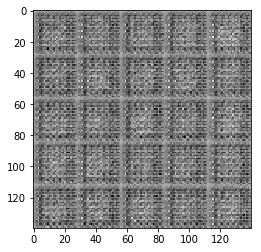

Epoch 1/2... Discriminator Loss: 2.5831... Generator Loss: 0.7893


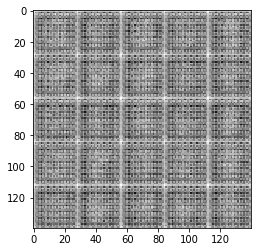

Epoch 1/2... Discriminator Loss: 1.2213... Generator Loss: 4.3033


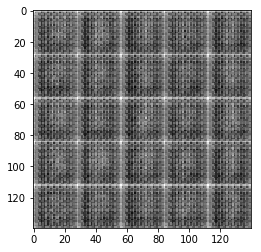

Epoch 1/2... Discriminator Loss: 1.7126... Generator Loss: 0.4862


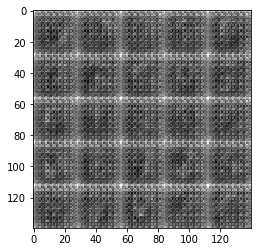

Epoch 1/2... Discriminator Loss: 1.6306... Generator Loss: 0.3300


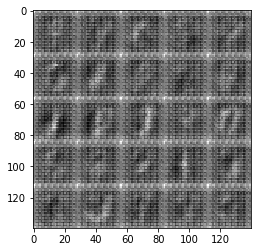

Epoch 1/2... Discriminator Loss: 1.3167... Generator Loss: 0.5331


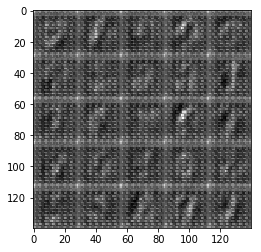

Epoch 1/2... Discriminator Loss: 1.6065... Generator Loss: 0.3146


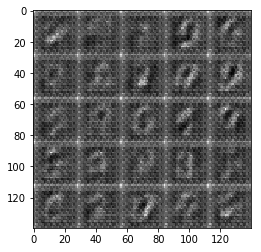

Epoch 1/2... Discriminator Loss: 1.1754... Generator Loss: 0.5976


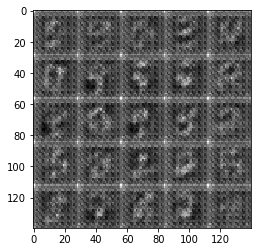

Epoch 1/2... Discriminator Loss: 1.1327... Generator Loss: 1.1187


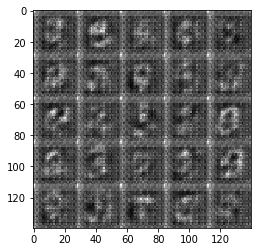

Epoch 1/2... Discriminator Loss: 1.2600... Generator Loss: 1.3040


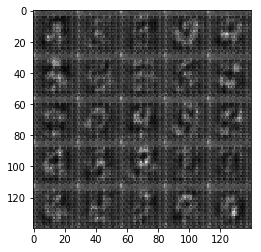

Epoch 1/2... Discriminator Loss: 0.9529... Generator Loss: 0.8571


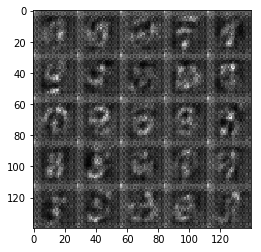

Epoch 1/2... Discriminator Loss: 1.3104... Generator Loss: 2.1442


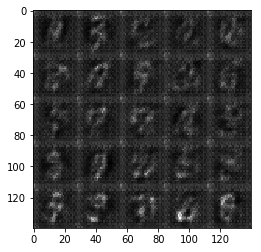

Epoch 1/2... Discriminator Loss: 1.6045... Generator Loss: 0.2880


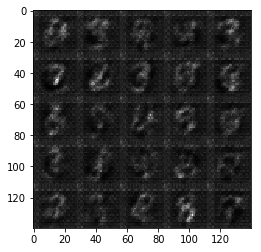

Epoch 1/2... Discriminator Loss: 0.8957... Generator Loss: 1.2218


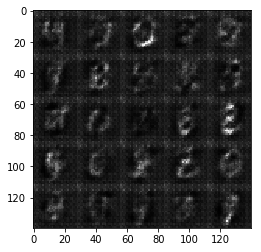

Epoch 1/2... Discriminator Loss: 0.8758... Generator Loss: 0.8735


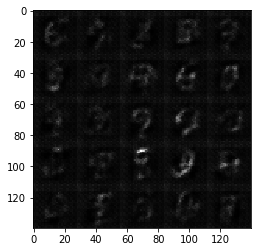

Epoch 1/2... Discriminator Loss: 1.0787... Generator Loss: 2.2934


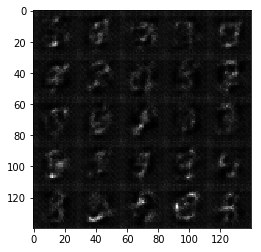

Epoch 1/2... Discriminator Loss: 1.5862... Generator Loss: 2.8198


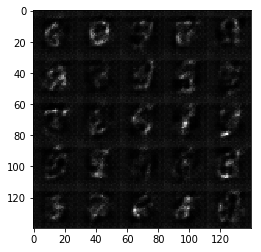

Epoch 1/2... Discriminator Loss: 0.8114... Generator Loss: 1.1298


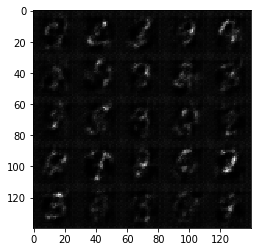

Epoch 1/2... Discriminator Loss: 0.9946... Generator Loss: 1.8194


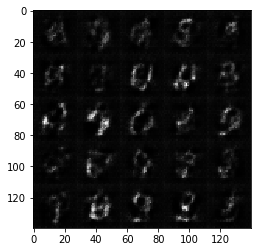

Epoch 1/2... Discriminator Loss: 0.7681... Generator Loss: 1.2866


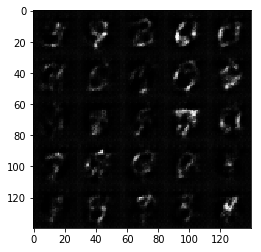

Epoch 1/2... Discriminator Loss: 1.0316... Generator Loss: 0.5886


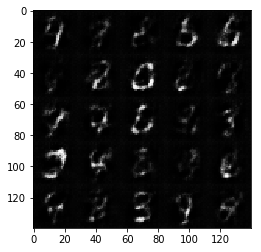

Epoch 1/2... Discriminator Loss: 0.8767... Generator Loss: 0.7550


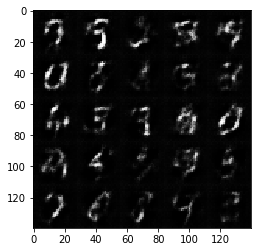

Epoch 1/2... Discriminator Loss: 1.4396... Generator Loss: 0.3329


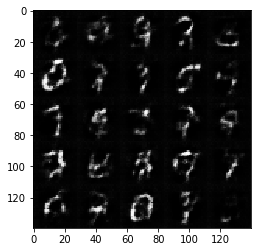

Epoch 1/2... Discriminator Loss: 0.8263... Generator Loss: 1.3013


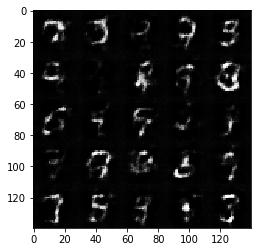

Epoch 1/2... Discriminator Loss: 1.0900... Generator Loss: 0.5585


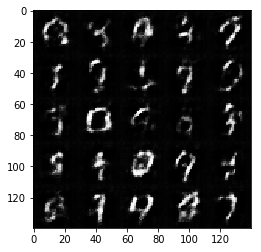

Epoch 1/2... Discriminator Loss: 1.0623... Generator Loss: 0.6253


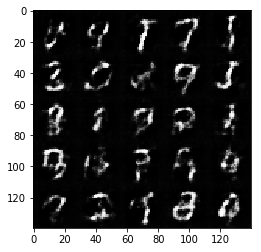

Epoch 1/2... Discriminator Loss: 1.0739... Generator Loss: 0.5216


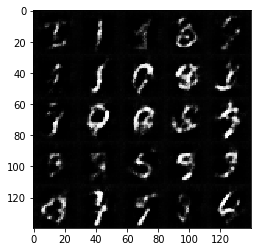

Epoch 1/2... Discriminator Loss: 0.9224... Generator Loss: 1.2607


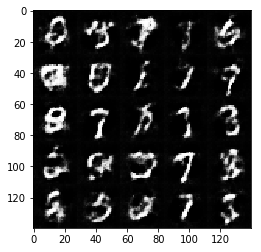

Epoch 1/2... Discriminator Loss: 1.1998... Generator Loss: 0.5075


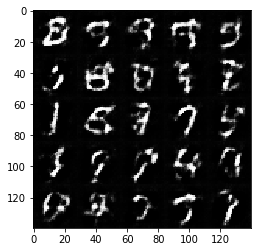

Epoch 1/2... Discriminator Loss: 1.1206... Generator Loss: 1.9399


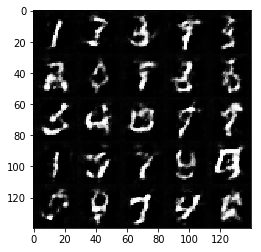

Epoch 1/2... Discriminator Loss: 1.1961... Generator Loss: 0.4749


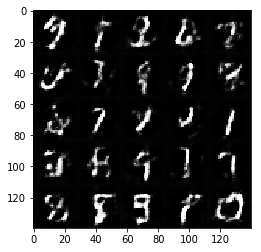

Epoch 1/2... Discriminator Loss: 1.6409... Generator Loss: 0.2593


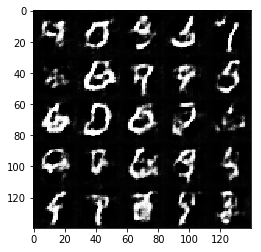

IndexError: list index out of range

In [13]:
batch_size = 64
z_dim = 100
learning_rate = 0.0002
beta1 = 0.4


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/1... Discriminator Loss: 2.2449... Generator Loss: 0.2424


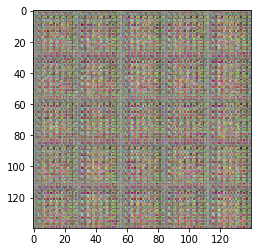

Epoch 1/1... Discriminator Loss: 1.3556... Generator Loss: 0.4426


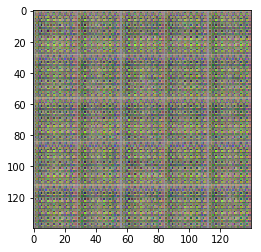

Epoch 1/1... Discriminator Loss: 0.7136... Generator Loss: 2.3052


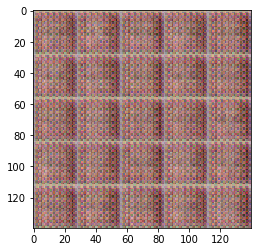

Epoch 1/1... Discriminator Loss: 4.1261... Generator Loss: 0.0316


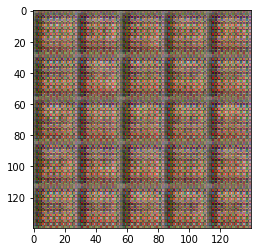

Epoch 1/1... Discriminator Loss: 1.2482... Generator Loss: 1.2085


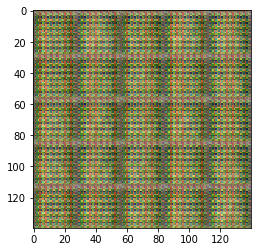

Epoch 1/1... Discriminator Loss: 2.1881... Generator Loss: 0.1982


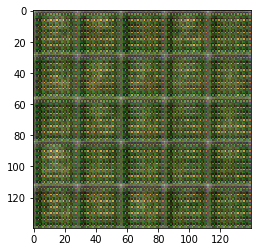

Epoch 1/1... Discriminator Loss: 1.0640... Generator Loss: 0.7536


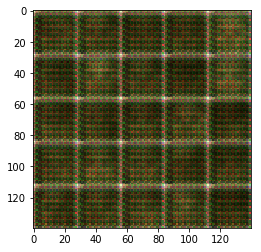

Epoch 1/1... Discriminator Loss: 0.7971... Generator Loss: 1.4204


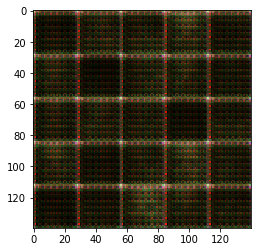

Epoch 1/1... Discriminator Loss: 1.2528... Generator Loss: 0.4917


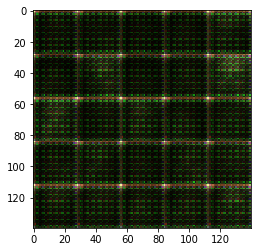

Epoch 1/1... Discriminator Loss: 1.2924... Generator Loss: 0.5657


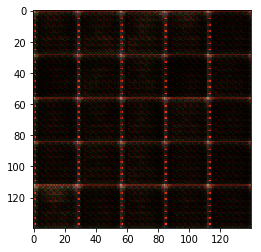

Epoch 1/1... Discriminator Loss: 1.1213... Generator Loss: 0.7248


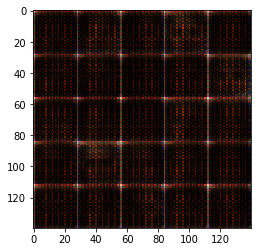

Epoch 1/1... Discriminator Loss: 1.9685... Generator Loss: 0.2844


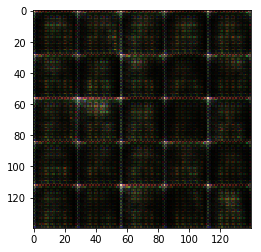

Epoch 1/1... Discriminator Loss: 1.2189... Generator Loss: 0.6787


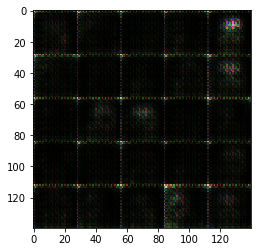

Epoch 1/1... Discriminator Loss: 1.1902... Generator Loss: 1.0207


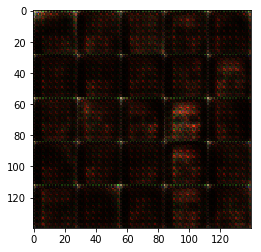

Epoch 1/1... Discriminator Loss: 1.6994... Generator Loss: 0.2949


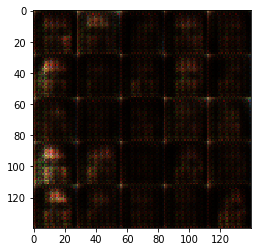

Epoch 1/1... Discriminator Loss: 1.6541... Generator Loss: 0.4664


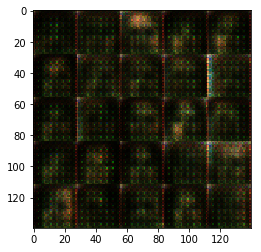

Epoch 1/1... Discriminator Loss: 1.5079... Generator Loss: 0.3942


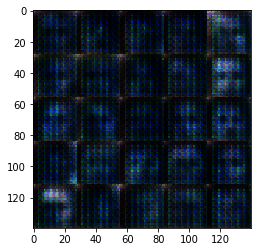

Epoch 1/1... Discriminator Loss: 1.8974... Generator Loss: 0.2714


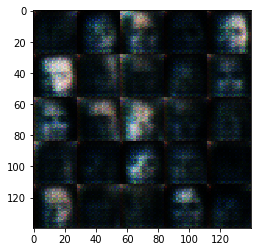

Epoch 1/1... Discriminator Loss: 1.7779... Generator Loss: 0.3028


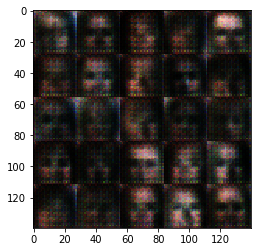

Epoch 1/1... Discriminator Loss: 1.8173... Generator Loss: 0.2702


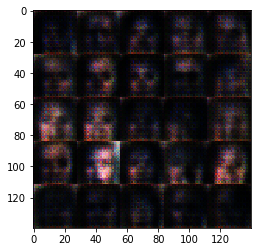

Epoch 1/1... Discriminator Loss: 1.0554... Generator Loss: 1.2745


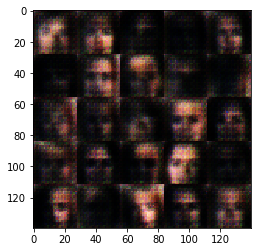

Epoch 1/1... Discriminator Loss: 1.4623... Generator Loss: 0.4431


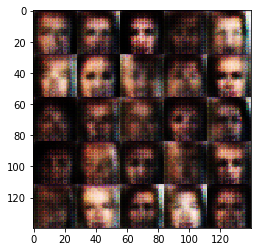

Epoch 1/1... Discriminator Loss: 1.5209... Generator Loss: 0.6417


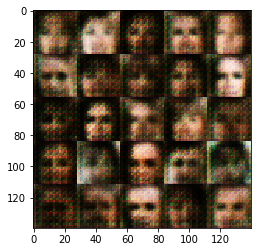

Epoch 1/1... Discriminator Loss: 1.0792... Generator Loss: 1.7824


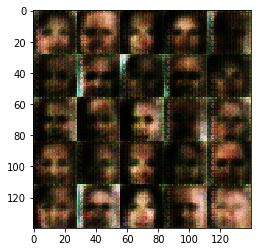

Epoch 1/1... Discriminator Loss: 1.3066... Generator Loss: 1.1498


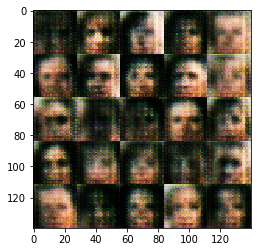

Epoch 1/1... Discriminator Loss: 1.5807... Generator Loss: 0.3580


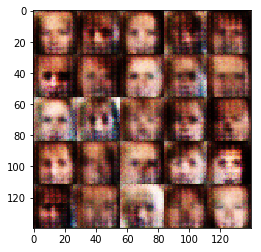

Epoch 1/1... Discriminator Loss: 1.6400... Generator Loss: 0.3692


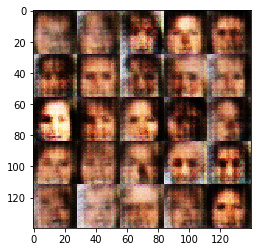

Epoch 1/1... Discriminator Loss: 1.5089... Generator Loss: 0.4707


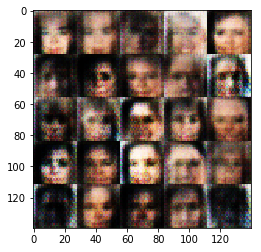

Epoch 1/1... Discriminator Loss: 1.2352... Generator Loss: 0.8424


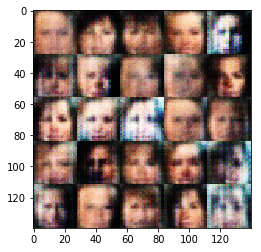

Epoch 1/1... Discriminator Loss: 1.3377... Generator Loss: 1.3318


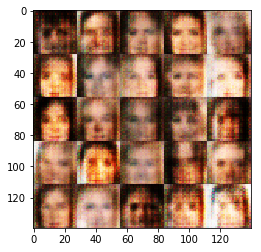

Epoch 1/1... Discriminator Loss: 1.7351... Generator Loss: 0.4900


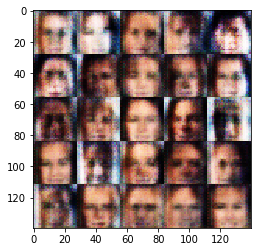

Epoch 1/1... Discriminator Loss: 1.3403... Generator Loss: 1.1327


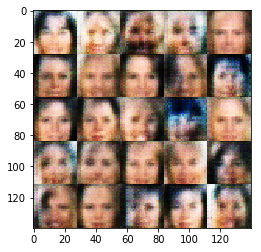

Epoch 1/1... Discriminator Loss: 1.5697... Generator Loss: 0.6417


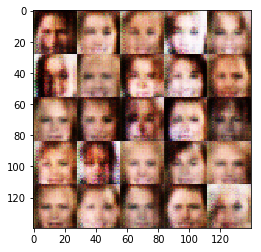

Epoch 1/1... Discriminator Loss: 1.8630... Generator Loss: 0.2782


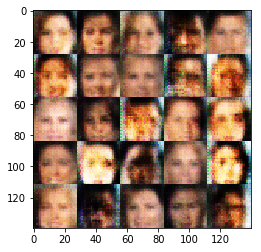

Epoch 1/1... Discriminator Loss: 1.5608... Generator Loss: 0.4345


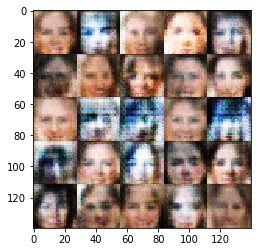

Epoch 1/1... Discriminator Loss: 1.7701... Generator Loss: 1.3552


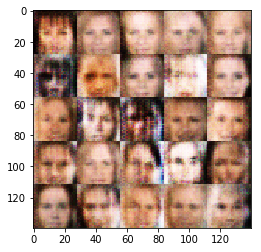

Epoch 1/1... Discriminator Loss: 1.3468... Generator Loss: 0.9610


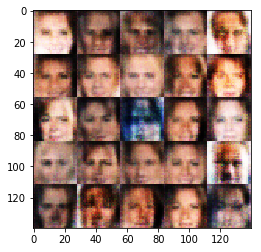

Epoch 1/1... Discriminator Loss: 1.3088... Generator Loss: 0.6602


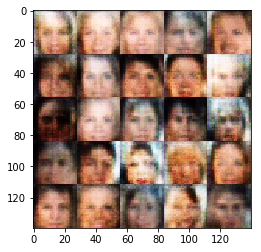

Epoch 1/1... Discriminator Loss: 1.4469... Generator Loss: 0.8940


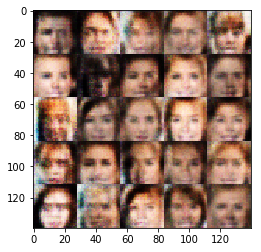

Epoch 1/1... Discriminator Loss: 1.4234... Generator Loss: 0.8529


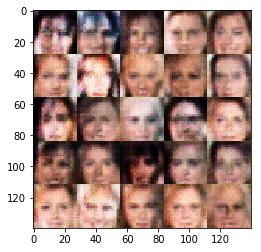

Epoch 1/1... Discriminator Loss: 1.2560... Generator Loss: 1.1698


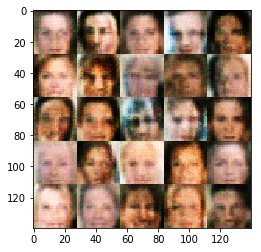

Epoch 1/1... Discriminator Loss: 1.3854... Generator Loss: 0.9964


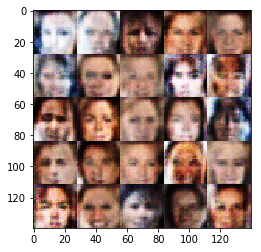

Epoch 1/1... Discriminator Loss: 1.2917... Generator Loss: 0.6519


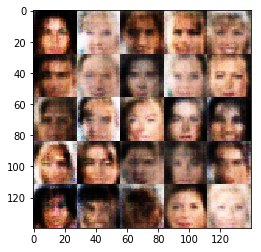

Epoch 1/1... Discriminator Loss: 1.8300... Generator Loss: 0.2682


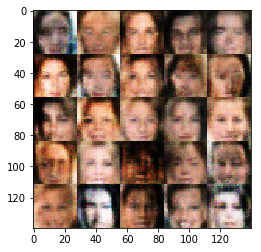

Epoch 1/1... Discriminator Loss: 1.3951... Generator Loss: 0.6410


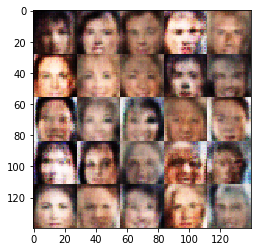

Epoch 1/1... Discriminator Loss: 1.3275... Generator Loss: 0.6943


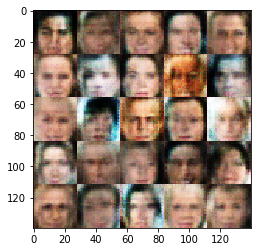

Epoch 1/1... Discriminator Loss: 1.4954... Generator Loss: 0.4305


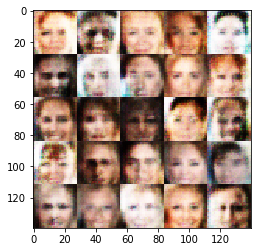

Epoch 1/1... Discriminator Loss: 1.4296... Generator Loss: 0.4750


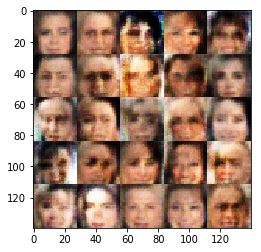

Epoch 1/1... Discriminator Loss: 1.4322... Generator Loss: 0.4839


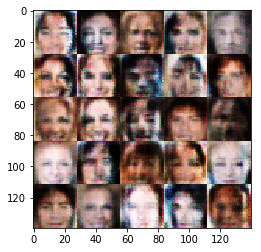

Epoch 1/1... Discriminator Loss: 1.4549... Generator Loss: 0.5049


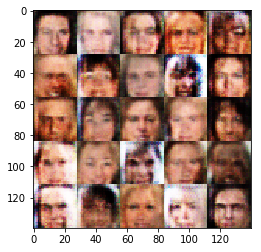

Epoch 1/1... Discriminator Loss: 1.3456... Generator Loss: 0.6737


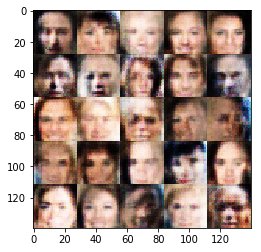

Epoch 1/1... Discriminator Loss: 1.3551... Generator Loss: 0.9574


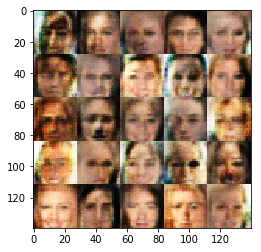

Epoch 1/1... Discriminator Loss: 1.3924... Generator Loss: 0.4598


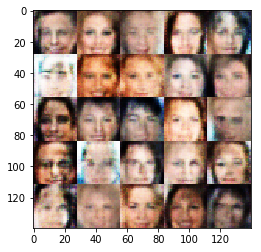

Epoch 1/1... Discriminator Loss: 1.3373... Generator Loss: 0.7619


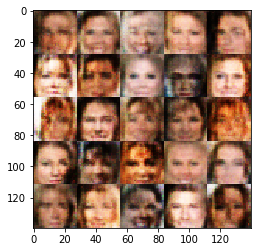

Epoch 1/1... Discriminator Loss: 1.4225... Generator Loss: 0.5015


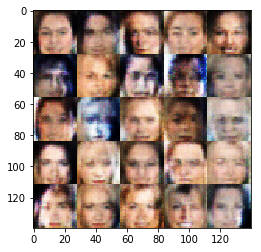

Epoch 1/1... Discriminator Loss: 1.3598... Generator Loss: 0.7372


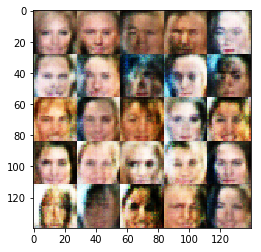

Epoch 1/1... Discriminator Loss: 1.2553... Generator Loss: 1.0184


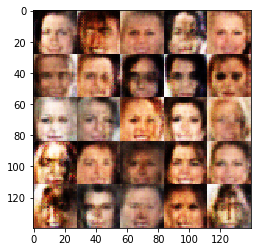

Epoch 1/1... Discriminator Loss: 1.2935... Generator Loss: 0.5115


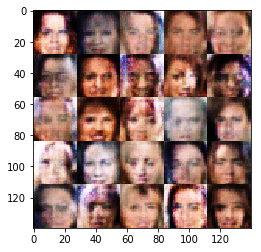

Epoch 1/1... Discriminator Loss: 1.3503... Generator Loss: 0.5397


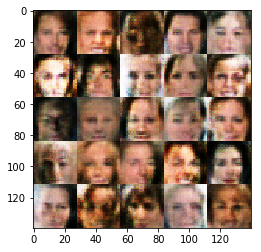

Epoch 1/1... Discriminator Loss: 1.5273... Generator Loss: 1.5932


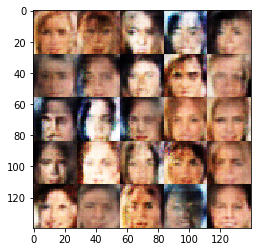

Epoch 1/1... Discriminator Loss: 1.3210... Generator Loss: 0.5368


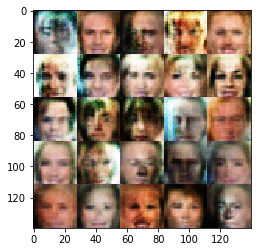

Epoch 1/1... Discriminator Loss: 1.2483... Generator Loss: 0.8561


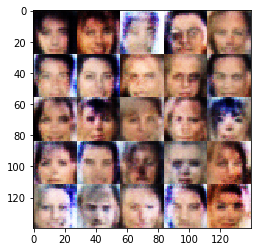

Epoch 1/1... Discriminator Loss: 1.2679... Generator Loss: 0.8523


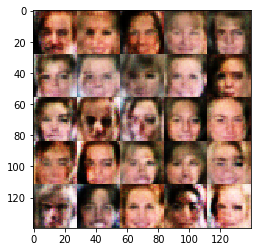

Epoch 1/1... Discriminator Loss: 1.5816... Generator Loss: 0.4419


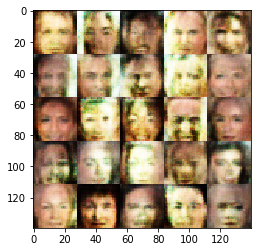

Epoch 1/1... Discriminator Loss: 1.4524... Generator Loss: 0.5548


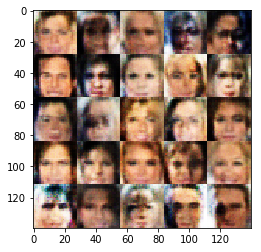

Epoch 1/1... Discriminator Loss: 1.6276... Generator Loss: 0.3192


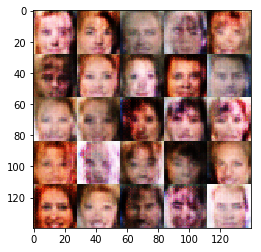

Epoch 1/1... Discriminator Loss: 1.7645... Generator Loss: 0.2479


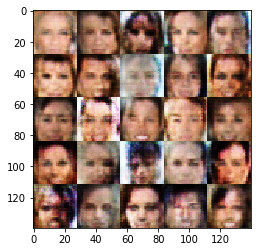

Epoch 1/1... Discriminator Loss: 1.3303... Generator Loss: 0.7273


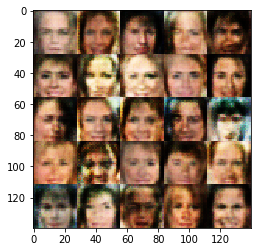

Epoch 1/1... Discriminator Loss: 1.1657... Generator Loss: 0.7064


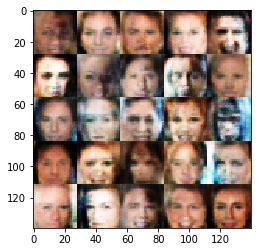

Epoch 1/1... Discriminator Loss: 1.5865... Generator Loss: 0.3276


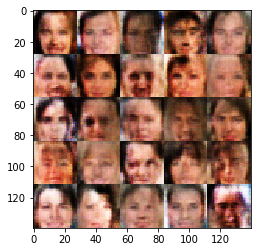

Epoch 1/1... Discriminator Loss: 1.2182... Generator Loss: 0.8285


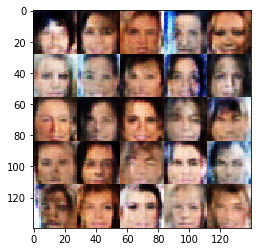

Epoch 1/1... Discriminator Loss: 1.0089... Generator Loss: 0.9486


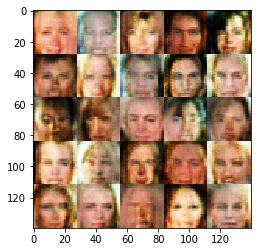

Epoch 1/1... Discriminator Loss: 1.3360... Generator Loss: 0.8138


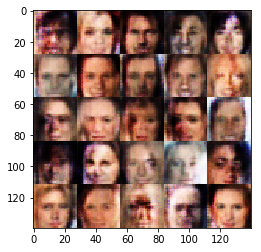

Epoch 1/1... Discriminator Loss: 1.5495... Generator Loss: 1.6495


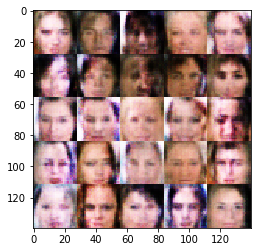

Epoch 1/1... Discriminator Loss: 1.1952... Generator Loss: 0.9867


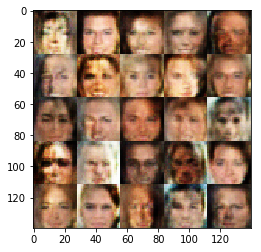

Epoch 1/1... Discriminator Loss: 1.3474... Generator Loss: 0.5299


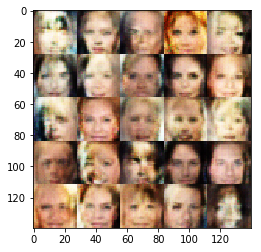

Epoch 1/1... Discriminator Loss: 1.3127... Generator Loss: 0.7019


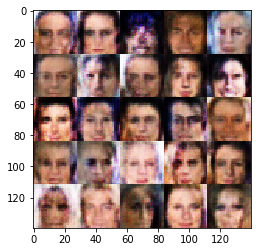

Epoch 1/1... Discriminator Loss: 1.5413... Generator Loss: 0.3815


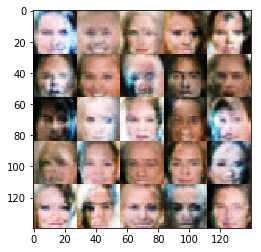

Epoch 1/1... Discriminator Loss: 1.2709... Generator Loss: 0.5150


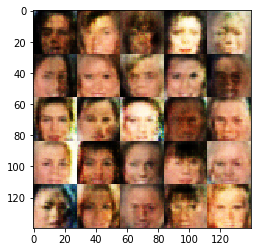

Epoch 1/1... Discriminator Loss: 1.2302... Generator Loss: 1.1267


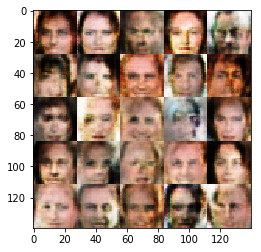

Epoch 1/1... Discriminator Loss: 1.5476... Generator Loss: 0.6562


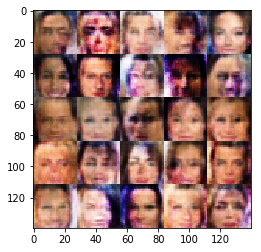

Epoch 1/1... Discriminator Loss: 1.3485... Generator Loss: 0.9449


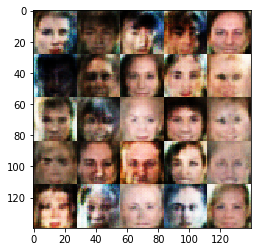

Epoch 1/1... Discriminator Loss: 1.2285... Generator Loss: 0.9356


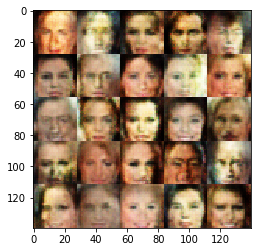

Epoch 1/1... Discriminator Loss: 1.1900... Generator Loss: 0.7121


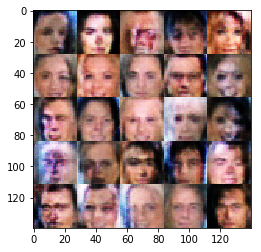

Epoch 1/1... Discriminator Loss: 1.7854... Generator Loss: 0.2509


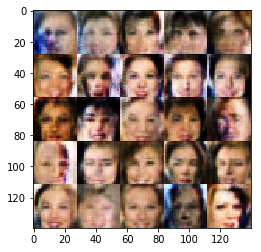

Epoch 1/1... Discriminator Loss: 1.2741... Generator Loss: 1.3149


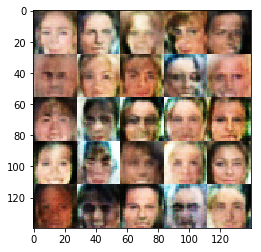

Epoch 1/1... Discriminator Loss: 1.4570... Generator Loss: 0.4706


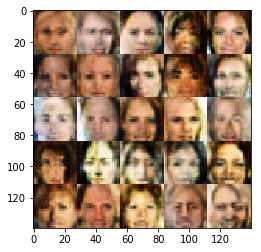

Epoch 1/1... Discriminator Loss: 1.5316... Generator Loss: 1.5108


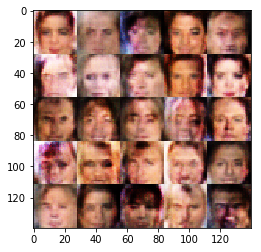

Epoch 1/1... Discriminator Loss: 1.3872... Generator Loss: 0.5611


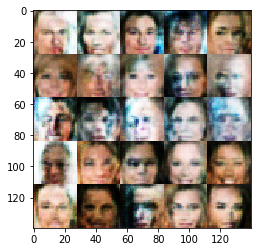

Epoch 1/1... Discriminator Loss: 0.9320... Generator Loss: 1.2133


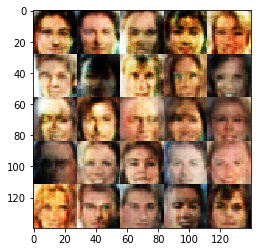

Epoch 1/1... Discriminator Loss: 1.5134... Generator Loss: 0.3952


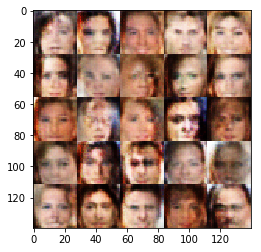

Epoch 1/1... Discriminator Loss: 1.1008... Generator Loss: 1.4631


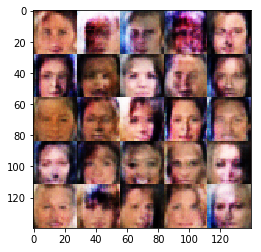

Epoch 1/1... Discriminator Loss: 1.5510... Generator Loss: 0.8728


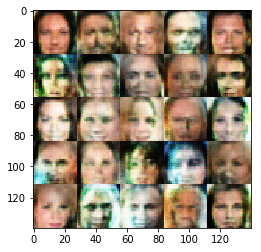

Epoch 1/1... Discriminator Loss: 1.1927... Generator Loss: 0.9295


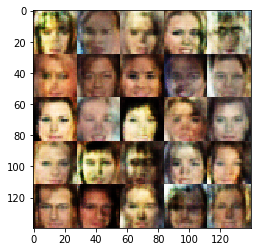

Epoch 1/1... Discriminator Loss: 1.5740... Generator Loss: 0.3350


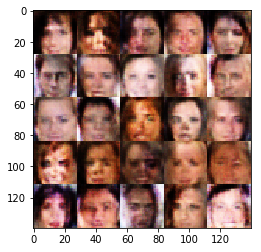

Epoch 1/1... Discriminator Loss: 1.4047... Generator Loss: 1.0017


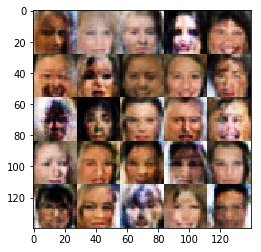

Epoch 1/1... Discriminator Loss: 1.1927... Generator Loss: 0.6790


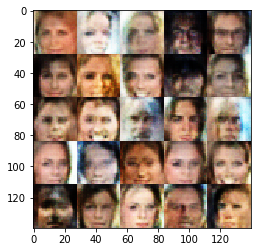

Epoch 1/1... Discriminator Loss: 1.5118... Generator Loss: 0.4166


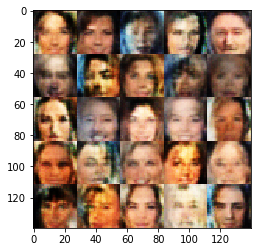

Epoch 1/1... Discriminator Loss: 1.4464... Generator Loss: 0.4026


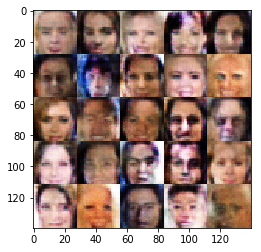

Epoch 1/1... Discriminator Loss: 1.5526... Generator Loss: 0.3411


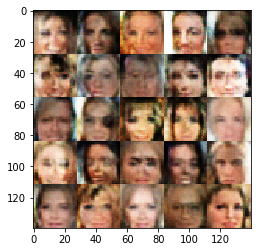

Epoch 1/1... Discriminator Loss: 1.2453... Generator Loss: 0.6178


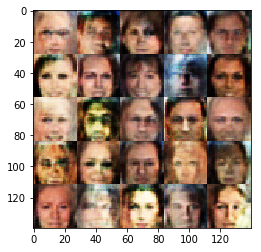

Epoch 1/1... Discriminator Loss: 1.0344... Generator Loss: 1.1616


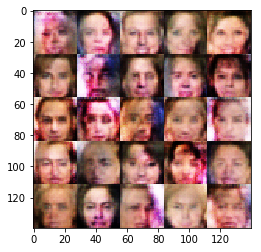

Epoch 1/1... Discriminator Loss: 1.8209... Generator Loss: 0.2635


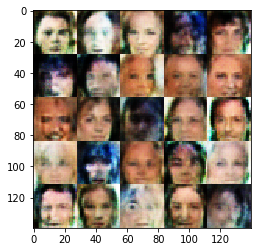

Epoch 1/1... Discriminator Loss: 1.2815... Generator Loss: 0.8030


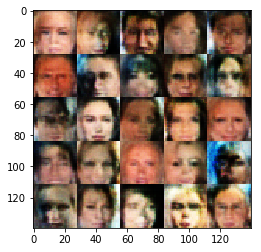

Epoch 1/1... Discriminator Loss: 1.3815... Generator Loss: 0.4553


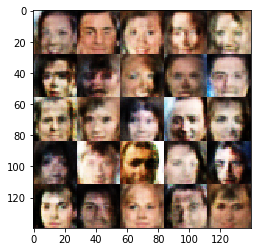

Epoch 1/1... Discriminator Loss: 1.2700... Generator Loss: 0.6743


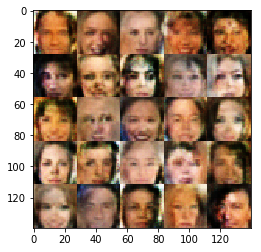

Epoch 1/1... Discriminator Loss: 1.1558... Generator Loss: 1.2126


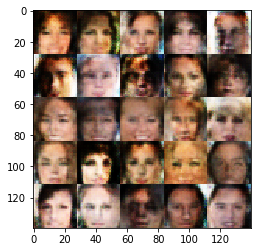

Epoch 1/1... Discriminator Loss: 1.3678... Generator Loss: 0.4208


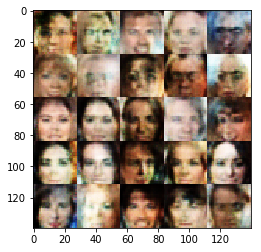

Epoch 1/1... Discriminator Loss: 1.3331... Generator Loss: 0.5546


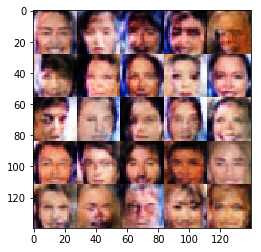

Epoch 1/1... Discriminator Loss: 1.3453... Generator Loss: 0.5197


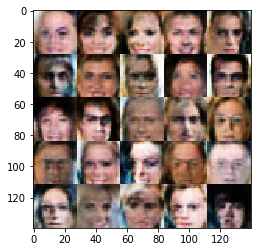

Epoch 1/1... Discriminator Loss: 1.3274... Generator Loss: 0.8282


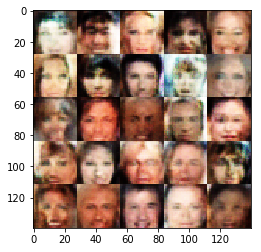

Epoch 1/1... Discriminator Loss: 1.0658... Generator Loss: 1.1918


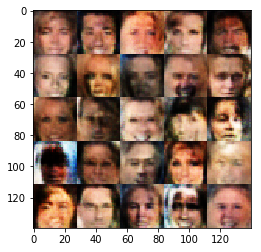

Epoch 1/1... Discriminator Loss: 1.3732... Generator Loss: 1.5487


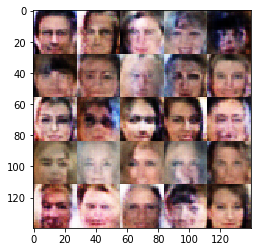

Epoch 1/1... Discriminator Loss: 1.1751... Generator Loss: 1.7323


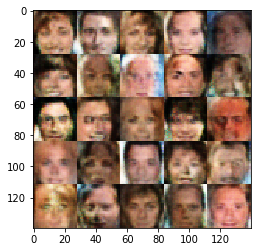

Epoch 1/1... Discriminator Loss: 1.3511... Generator Loss: 0.4427


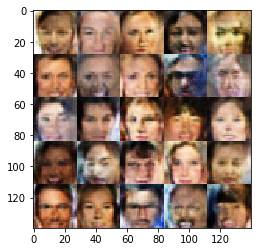

Epoch 1/1... Discriminator Loss: 1.3485... Generator Loss: 0.5246


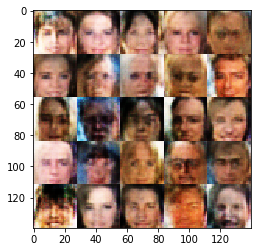

Epoch 1/1... Discriminator Loss: 1.2491... Generator Loss: 0.6248


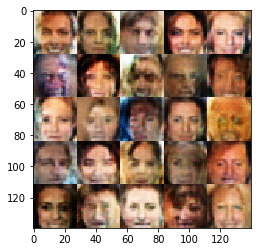

Epoch 1/1... Discriminator Loss: 1.7479... Generator Loss: 0.2613


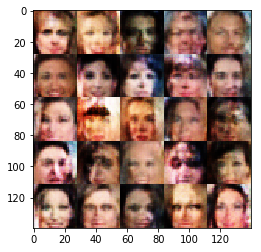

Epoch 1/1... Discriminator Loss: 1.2404... Generator Loss: 0.5905


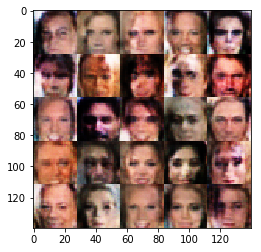

Epoch 1/1... Discriminator Loss: 1.4893... Generator Loss: 0.5680


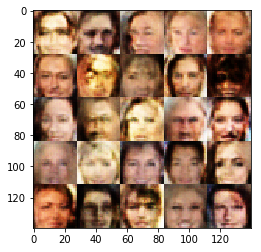

Epoch 1/1... Discriminator Loss: 1.3230... Generator Loss: 0.6563


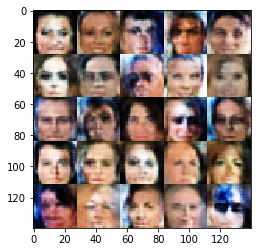

Epoch 1/1... Discriminator Loss: 0.9683... Generator Loss: 1.0065


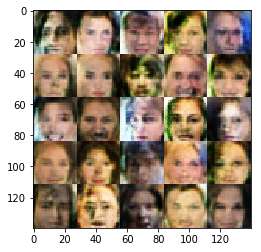

Epoch 1/1... Discriminator Loss: 1.2423... Generator Loss: 1.1942


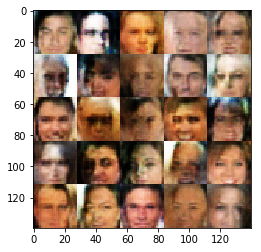

Epoch 1/1... Discriminator Loss: 1.0978... Generator Loss: 0.8726


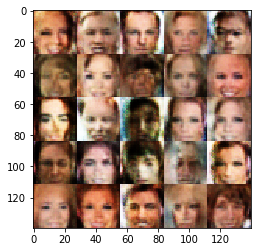

Epoch 1/1... Discriminator Loss: 1.1065... Generator Loss: 0.9495


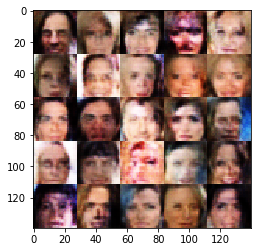

Epoch 1/1... Discriminator Loss: 1.0129... Generator Loss: 0.8072


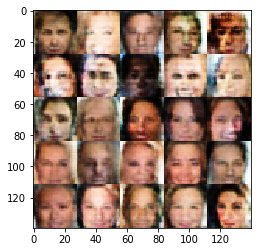

Epoch 1/1... Discriminator Loss: 1.1918... Generator Loss: 1.0195


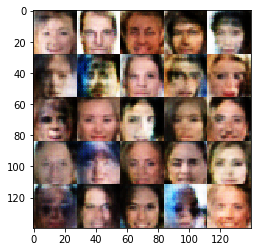

Epoch 1/1... Discriminator Loss: 1.2036... Generator Loss: 0.6943


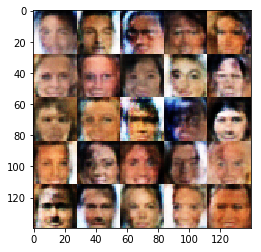

Epoch 1/1... Discriminator Loss: 1.0909... Generator Loss: 1.1797


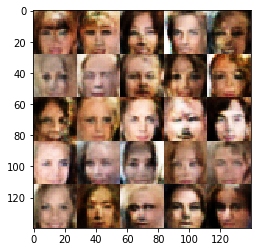

Epoch 1/1... Discriminator Loss: 1.3785... Generator Loss: 0.5197


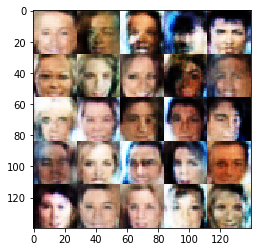

Epoch 1/1... Discriminator Loss: 1.4927... Generator Loss: 0.3939


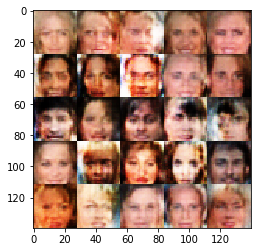

Epoch 1/1... Discriminator Loss: 1.1497... Generator Loss: 0.6058


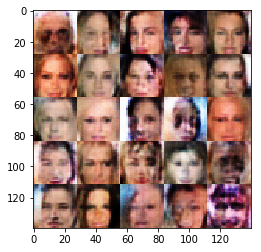

Epoch 1/1... Discriminator Loss: 1.3431... Generator Loss: 1.7639


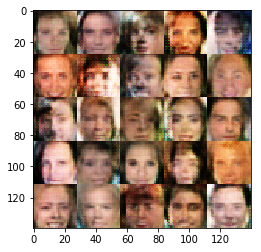

Epoch 1/1... Discriminator Loss: 1.1032... Generator Loss: 1.0242


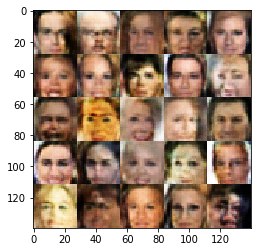

Epoch 1/1... Discriminator Loss: 1.4298... Generator Loss: 0.4382


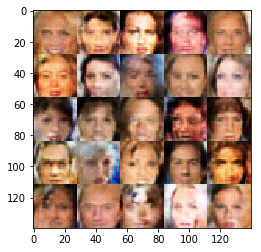

Epoch 1/1... Discriminator Loss: 1.6452... Generator Loss: 0.2887


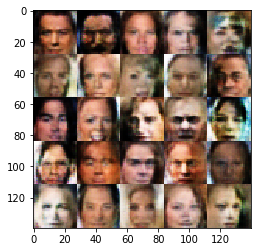

Epoch 1/1... Discriminator Loss: 1.2956... Generator Loss: 0.5243


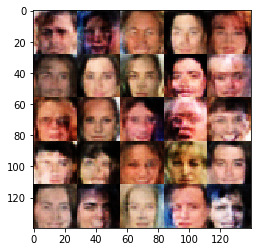

Epoch 1/1... Discriminator Loss: 1.1149... Generator Loss: 0.7961


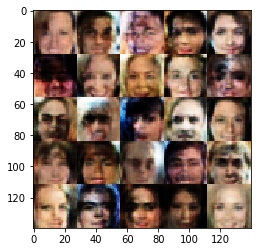

Epoch 1/1... Discriminator Loss: 1.1667... Generator Loss: 0.9201


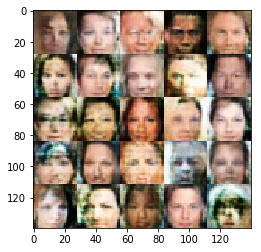

Epoch 1/1... Discriminator Loss: 1.1433... Generator Loss: 0.6731


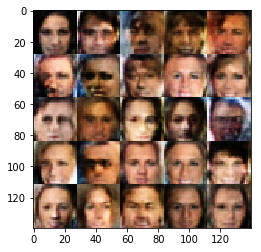

Epoch 1/1... Discriminator Loss: 1.4719... Generator Loss: 0.3574


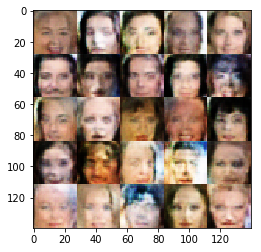

Epoch 1/1... Discriminator Loss: 1.1688... Generator Loss: 0.6664


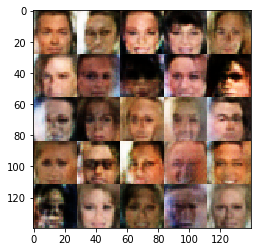

Epoch 1/1... Discriminator Loss: 1.4506... Generator Loss: 2.1237


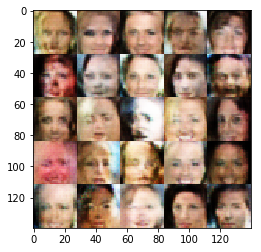

Epoch 1/1... Discriminator Loss: 1.0233... Generator Loss: 0.8222


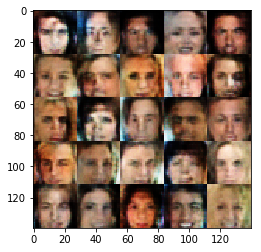

Epoch 1/1... Discriminator Loss: 1.0152... Generator Loss: 1.1039


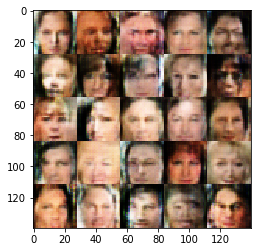

Epoch 1/1... Discriminator Loss: 1.3310... Generator Loss: 0.4351


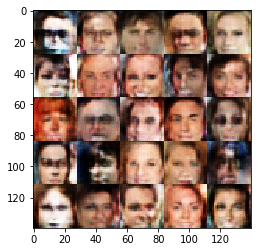

Epoch 1/1... Discriminator Loss: 1.7597... Generator Loss: 0.3636


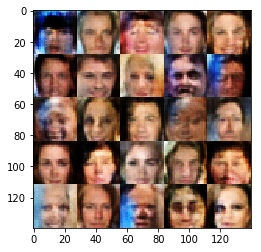

Epoch 1/1... Discriminator Loss: 1.5111... Generator Loss: 1.1552


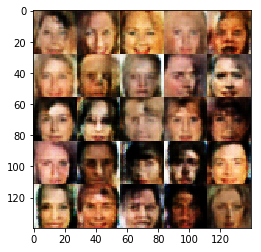

Epoch 1/1... Discriminator Loss: 1.0082... Generator Loss: 0.7848


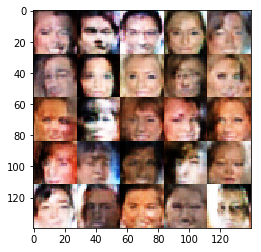

Epoch 1/1... Discriminator Loss: 1.5357... Generator Loss: 0.3301


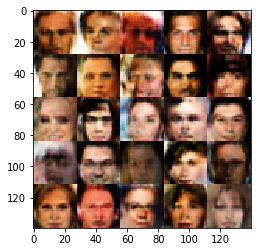

Epoch 1/1... Discriminator Loss: 1.3631... Generator Loss: 0.6065


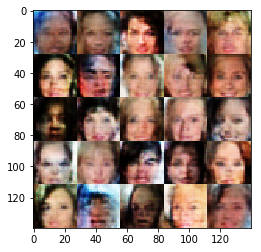

Epoch 1/1... Discriminator Loss: 1.2532... Generator Loss: 0.5325


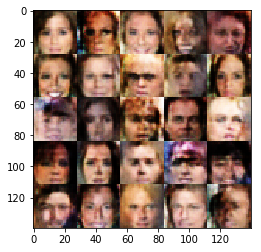

Epoch 1/1... Discriminator Loss: 1.4143... Generator Loss: 0.4006


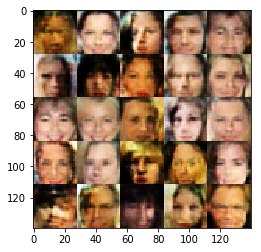

Epoch 1/1... Discriminator Loss: 0.9734... Generator Loss: 0.8602


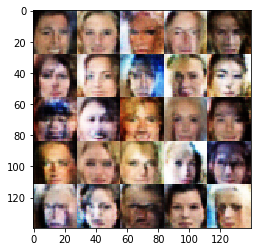

Epoch 1/1... Discriminator Loss: 1.4531... Generator Loss: 0.3651


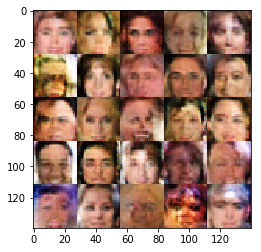

Epoch 1/1... Discriminator Loss: 1.1309... Generator Loss: 0.9117


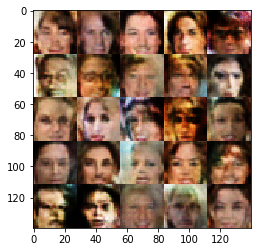

Epoch 1/1... Discriminator Loss: 1.1266... Generator Loss: 0.7159


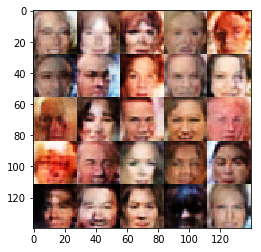

Epoch 1/1... Discriminator Loss: 1.0829... Generator Loss: 1.0841


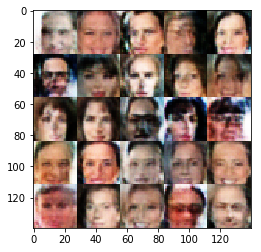

Epoch 1/1... Discriminator Loss: 1.2626... Generator Loss: 0.8222


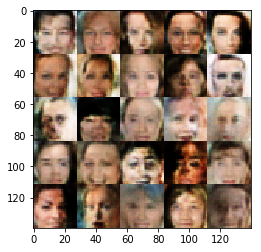

Epoch 1/1... Discriminator Loss: 1.2497... Generator Loss: 1.4498


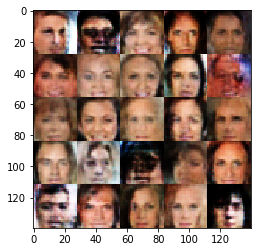

Epoch 1/1... Discriminator Loss: 1.4643... Generator Loss: 0.4204


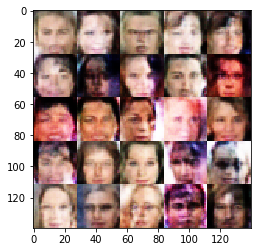

Epoch 1/1... Discriminator Loss: 1.6208... Generator Loss: 0.2928


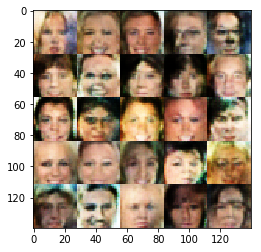

Epoch 1/1... Discriminator Loss: 1.4501... Generator Loss: 1.3460


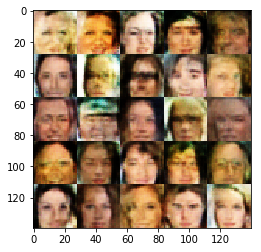

Epoch 1/1... Discriminator Loss: 1.2159... Generator Loss: 0.8263


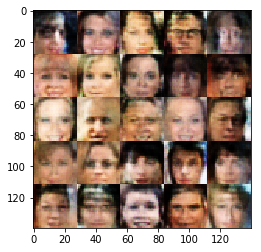

Epoch 1/1... Discriminator Loss: 1.0579... Generator Loss: 1.1776


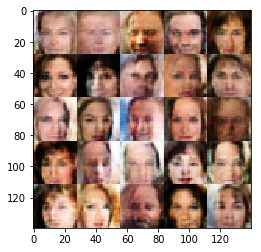

Epoch 1/1... Discriminator Loss: 1.6082... Generator Loss: 0.3120


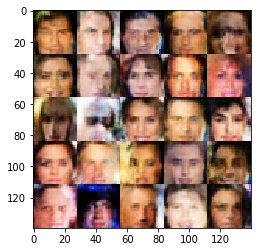

Epoch 1/1... Discriminator Loss: 1.0966... Generator Loss: 0.8625


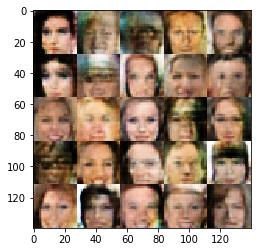

Epoch 1/1... Discriminator Loss: 0.8719... Generator Loss: 1.2731


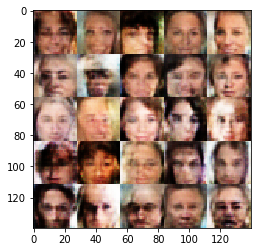

Epoch 1/1... Discriminator Loss: 0.9860... Generator Loss: 0.9908


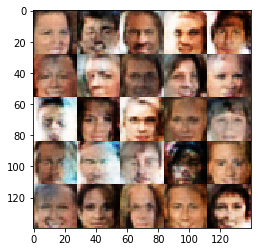

Epoch 1/1... Discriminator Loss: 1.1530... Generator Loss: 0.9572


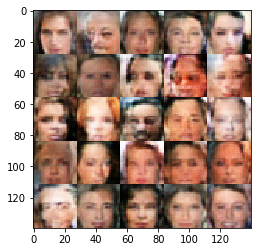

Epoch 1/1... Discriminator Loss: 1.1869... Generator Loss: 0.6626


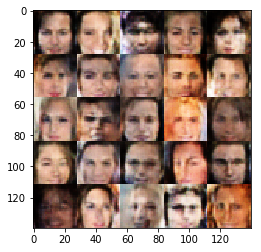

Epoch 1/1... Discriminator Loss: 0.8001... Generator Loss: 1.0945


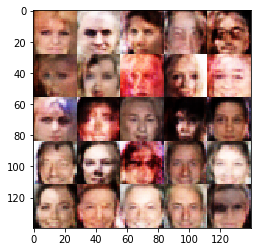

Epoch 1/1... Discriminator Loss: 0.9654... Generator Loss: 1.2195


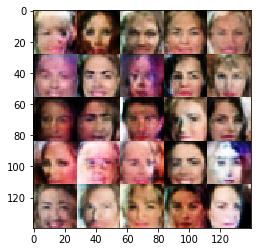

Epoch 1/1... Discriminator Loss: 1.2525... Generator Loss: 0.4262


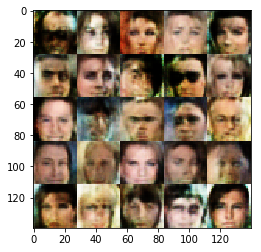

Epoch 1/1... Discriminator Loss: 1.0721... Generator Loss: 1.1075


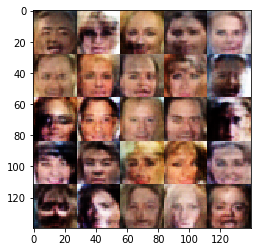

Epoch 1/1... Discriminator Loss: 1.3885... Generator Loss: 0.9221


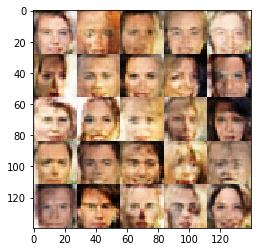

Epoch 1/1... Discriminator Loss: 1.0193... Generator Loss: 0.9680


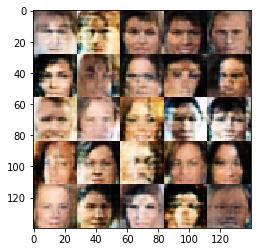

Epoch 1/1... Discriminator Loss: 1.2254... Generator Loss: 0.5530


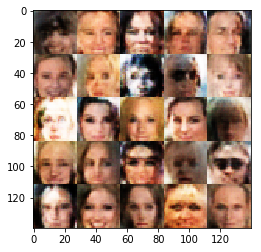

Epoch 1/1... Discriminator Loss: 1.2794... Generator Loss: 0.4635


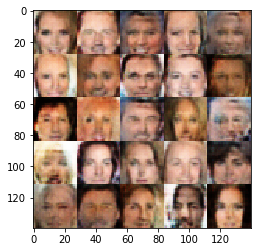

Epoch 1/1... Discriminator Loss: 1.1089... Generator Loss: 0.9365


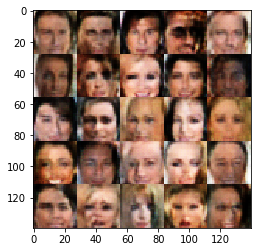

Epoch 1/1... Discriminator Loss: 1.4500... Generator Loss: 0.4183


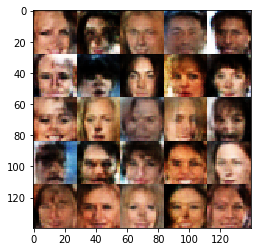

Epoch 1/1... Discriminator Loss: 1.1294... Generator Loss: 0.7090


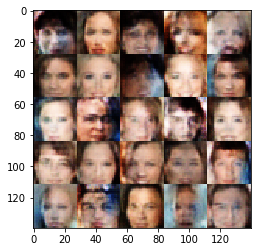

Epoch 1/1... Discriminator Loss: 0.8551... Generator Loss: 1.4858


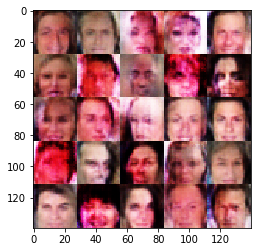

Epoch 1/1... Discriminator Loss: 0.9518... Generator Loss: 1.1576


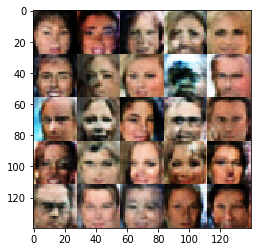

Epoch 1/1... Discriminator Loss: 0.9994... Generator Loss: 1.2540


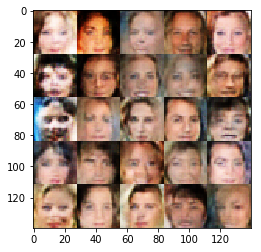

Epoch 1/1... Discriminator Loss: 1.4353... Generator Loss: 1.2532


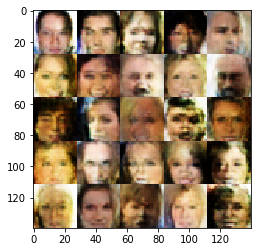

Epoch 1/1... Discriminator Loss: 1.2985... Generator Loss: 0.5947


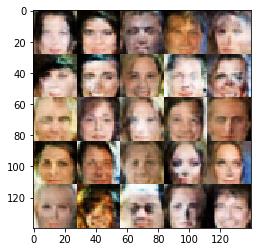

Epoch 1/1... Discriminator Loss: 1.5580... Generator Loss: 1.1516


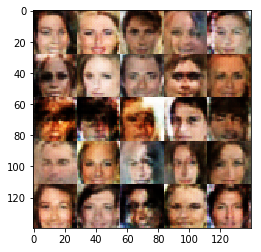

Epoch 1/1... Discriminator Loss: 1.2430... Generator Loss: 0.5440


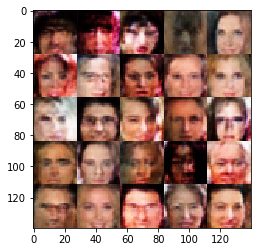

Epoch 1/1... Discriminator Loss: 2.2894... Generator Loss: 2.0163


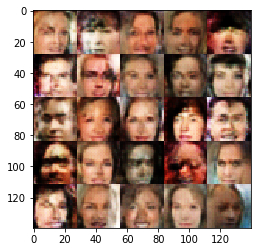

Epoch 1/1... Discriminator Loss: 0.9607... Generator Loss: 1.1485


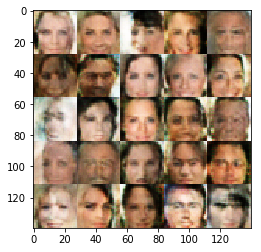

Epoch 1/1... Discriminator Loss: 1.0354... Generator Loss: 1.1348


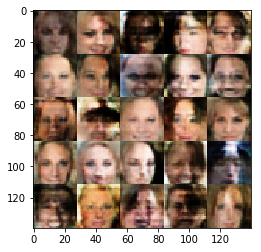

Epoch 1/1... Discriminator Loss: 1.2456... Generator Loss: 0.8955


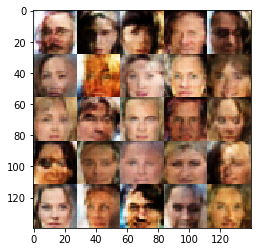

Epoch 1/1... Discriminator Loss: 0.9863... Generator Loss: 0.8536


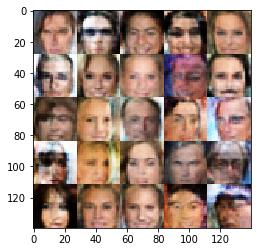

Epoch 1/1... Discriminator Loss: 1.2790... Generator Loss: 0.5093


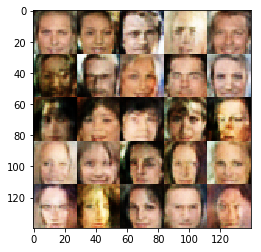

Epoch 1/1... Discriminator Loss: 1.1591... Generator Loss: 1.1533


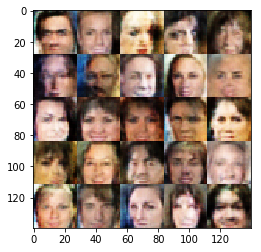

Epoch 1/1... Discriminator Loss: 0.7667... Generator Loss: 1.3803


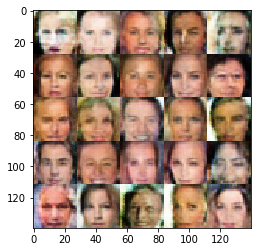

Epoch 1/1... Discriminator Loss: 1.1441... Generator Loss: 0.9904


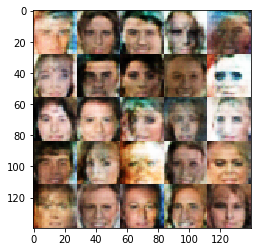

Epoch 1/1... Discriminator Loss: 1.2274... Generator Loss: 0.5639


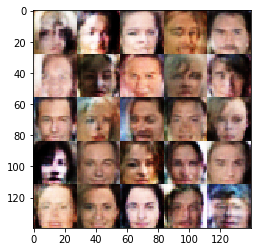

Epoch 1/1... Discriminator Loss: 1.0230... Generator Loss: 1.3707


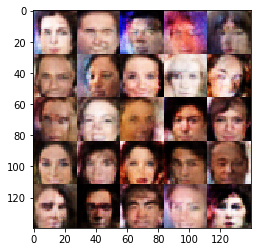

Epoch 1/1... Discriminator Loss: 1.4390... Generator Loss: 0.4072


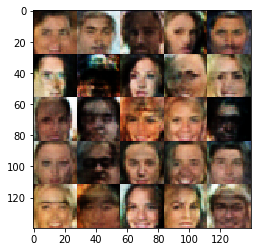

Epoch 1/1... Discriminator Loss: 0.8792... Generator Loss: 1.2799


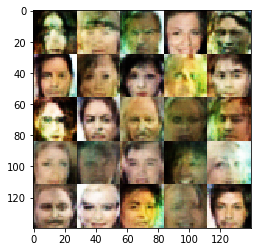

Epoch 1/1... Discriminator Loss: 1.1768... Generator Loss: 1.4679


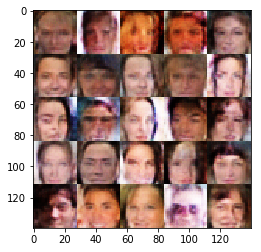

Epoch 1/1... Discriminator Loss: 1.3520... Generator Loss: 0.6055


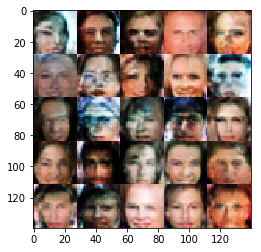

Epoch 1/1... Discriminator Loss: 1.1841... Generator Loss: 0.5466


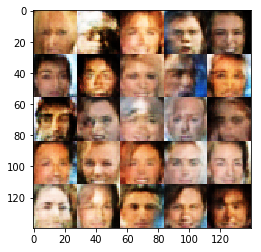

Epoch 1/1... Discriminator Loss: 1.3902... Generator Loss: 0.4518


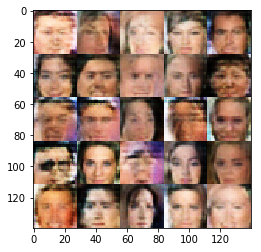

Epoch 1/1... Discriminator Loss: 1.3137... Generator Loss: 1.1688


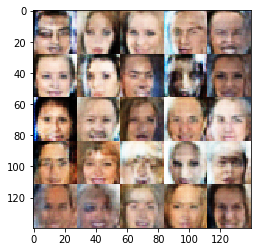

Epoch 1/1... Discriminator Loss: 1.5230... Generator Loss: 0.3730


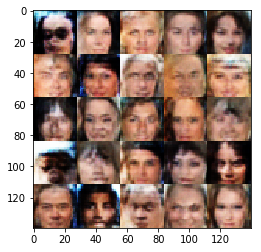

Epoch 1/1... Discriminator Loss: 1.0205... Generator Loss: 1.2833


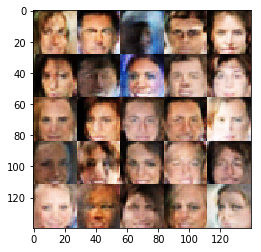

Epoch 1/1... Discriminator Loss: 1.7645... Generator Loss: 0.2619


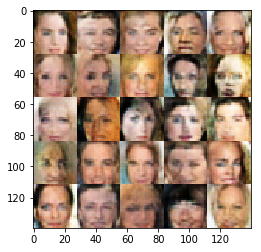

Epoch 1/1... Discriminator Loss: 1.0097... Generator Loss: 1.3598


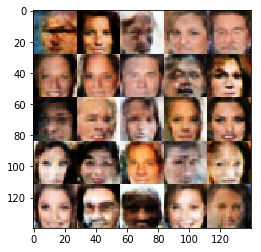

Epoch 1/1... Discriminator Loss: 1.5836... Generator Loss: 0.3500


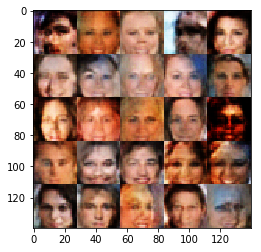

Epoch 1/1... Discriminator Loss: 1.4223... Generator Loss: 1.8128


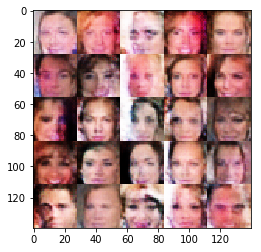

Epoch 1/1... Discriminator Loss: 1.1760... Generator Loss: 1.1527


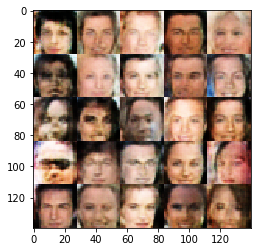

Epoch 1/1... Discriminator Loss: 1.3886... Generator Loss: 0.4360


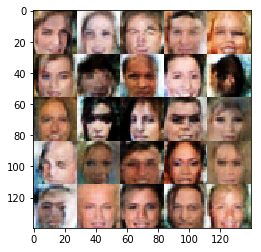

Epoch 1/1... Discriminator Loss: 0.9832... Generator Loss: 1.0186


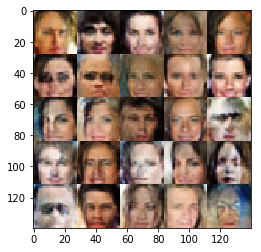

Epoch 1/1... Discriminator Loss: 1.3696... Generator Loss: 1.3395


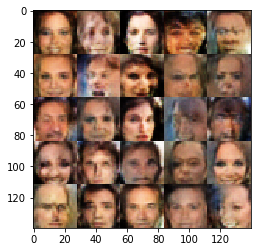

Epoch 1/1... Discriminator Loss: 1.0676... Generator Loss: 0.8246


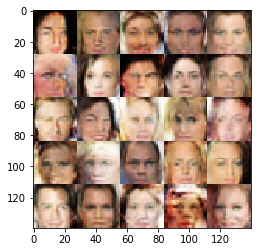

Epoch 1/1... Discriminator Loss: 1.2858... Generator Loss: 1.0724


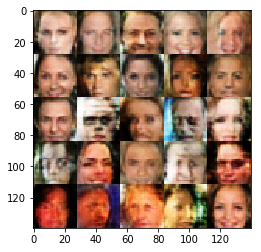

Epoch 1/1... Discriminator Loss: 1.0879... Generator Loss: 0.7200


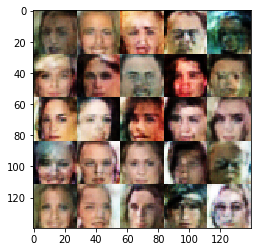

Epoch 1/1... Discriminator Loss: 1.4561... Generator Loss: 0.3709


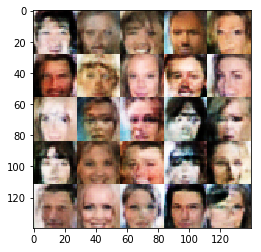

Epoch 1/1... Discriminator Loss: 1.0366... Generator Loss: 0.7257


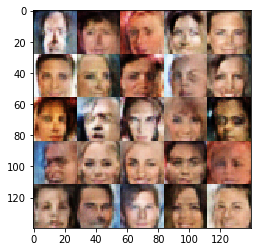

Epoch 1/1... Discriminator Loss: 1.3146... Generator Loss: 0.5053


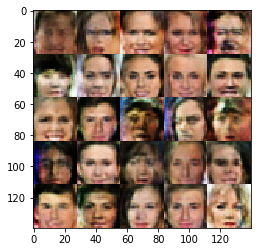

Epoch 1/1... Discriminator Loss: 1.6891... Generator Loss: 0.2832


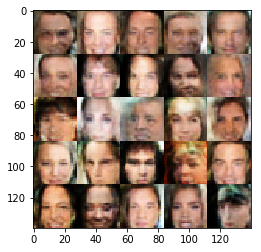

Epoch 1/1... Discriminator Loss: 1.0896... Generator Loss: 1.0914


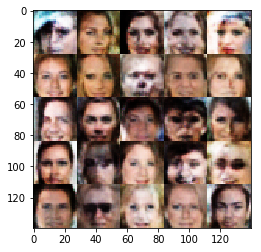

Epoch 1/1... Discriminator Loss: 1.7090... Generator Loss: 0.2708


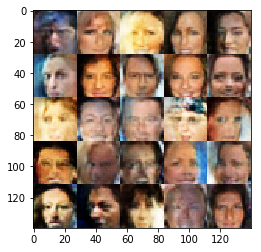

Epoch 1/1... Discriminator Loss: 1.5450... Generator Loss: 0.4902


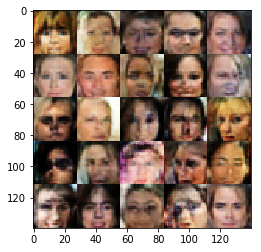

Epoch 1/1... Discriminator Loss: 0.9426... Generator Loss: 0.7438


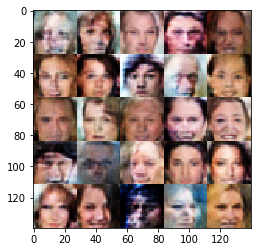

Epoch 1/1... Discriminator Loss: 1.2964... Generator Loss: 0.6381


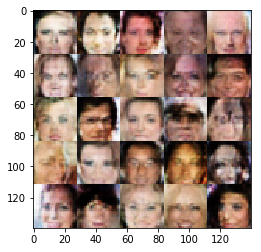

Epoch 1/1... Discriminator Loss: 1.4500... Generator Loss: 0.3496


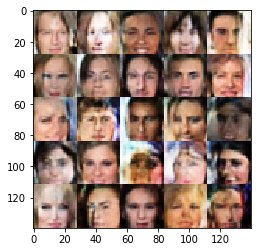

Epoch 1/1... Discriminator Loss: 1.0078... Generator Loss: 1.3701


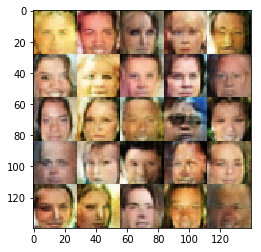

Epoch 1/1... Discriminator Loss: 0.9755... Generator Loss: 1.1675


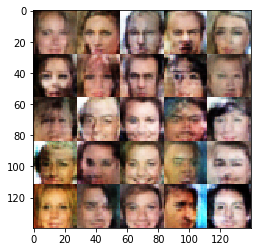

Epoch 1/1... Discriminator Loss: 1.5197... Generator Loss: 0.3276


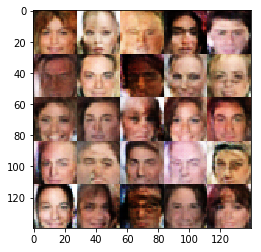

Epoch 1/1... Discriminator Loss: 0.8278... Generator Loss: 1.8054


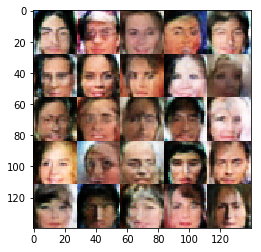

Epoch 1/1... Discriminator Loss: 1.4067... Generator Loss: 0.4167


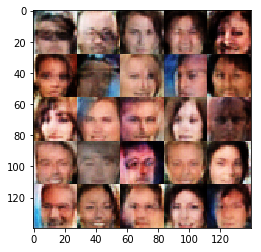

Epoch 1/1... Discriminator Loss: 1.2590... Generator Loss: 0.4408


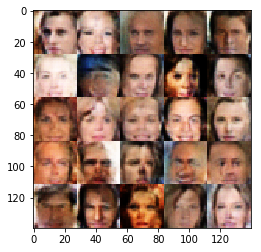

Epoch 1/1... Discriminator Loss: 0.9150... Generator Loss: 1.0265


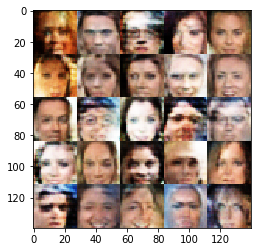

Epoch 1/1... Discriminator Loss: 0.9981... Generator Loss: 0.6448


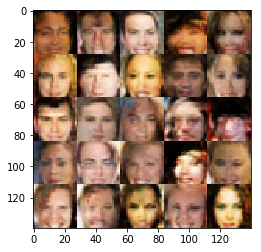

Epoch 1/1... Discriminator Loss: 2.6717... Generator Loss: 2.2423


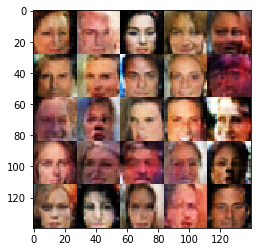

Epoch 1/1... Discriminator Loss: 1.3907... Generator Loss: 1.5438


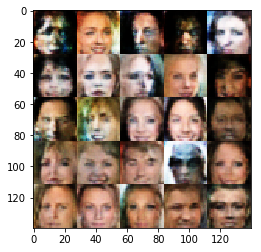

Epoch 1/1... Discriminator Loss: 0.8685... Generator Loss: 0.8400


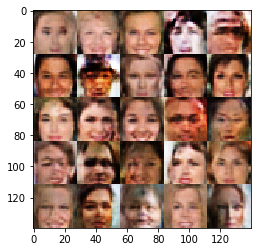

Epoch 1/1... Discriminator Loss: 0.6875... Generator Loss: 1.1415


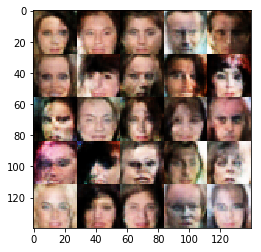

Epoch 1/1... Discriminator Loss: 1.1047... Generator Loss: 0.5666


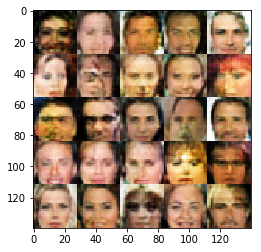

Epoch 1/1... Discriminator Loss: 1.0446... Generator Loss: 0.7175


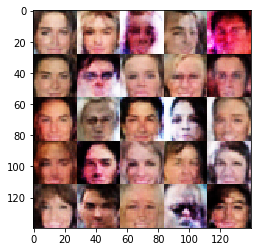

Epoch 1/1... Discriminator Loss: 1.1267... Generator Loss: 1.2181


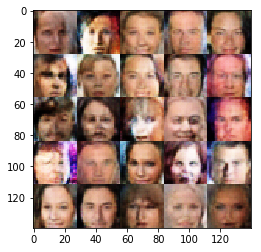

Epoch 1/1... Discriminator Loss: 0.9566... Generator Loss: 0.8073


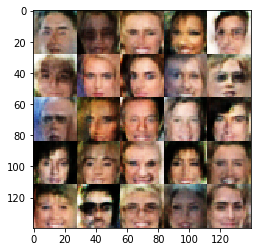

Epoch 1/1... Discriminator Loss: 0.7073... Generator Loss: 2.0280


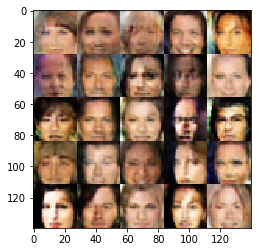

Epoch 1/1... Discriminator Loss: 1.5044... Generator Loss: 0.5340


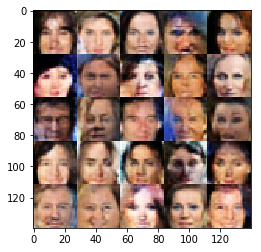

Epoch 1/1... Discriminator Loss: 1.4034... Generator Loss: 0.3919


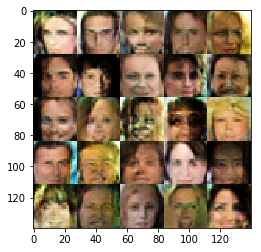

Epoch 1/1... Discriminator Loss: 1.3163... Generator Loss: 0.6584


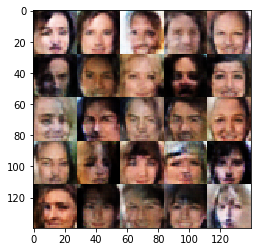

Epoch 1/1... Discriminator Loss: 1.0349... Generator Loss: 0.6665


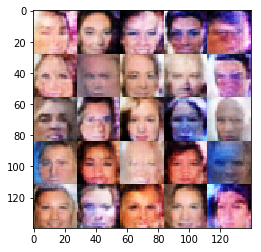

Epoch 1/1... Discriminator Loss: 1.4108... Generator Loss: 2.0621


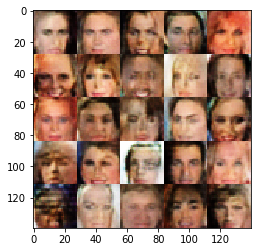

Epoch 1/1... Discriminator Loss: 1.0472... Generator Loss: 0.7625


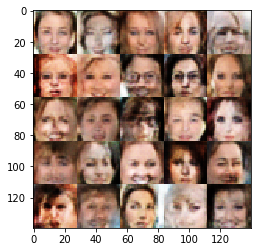

Epoch 1/1... Discriminator Loss: 1.7457... Generator Loss: 0.2698


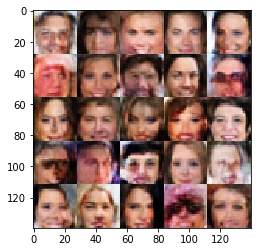

Epoch 1/1... Discriminator Loss: 1.2037... Generator Loss: 0.5629


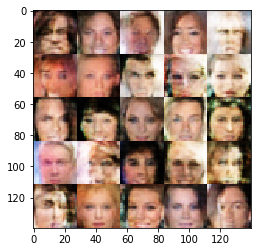

Epoch 1/1... Discriminator Loss: 0.8777... Generator Loss: 0.8744


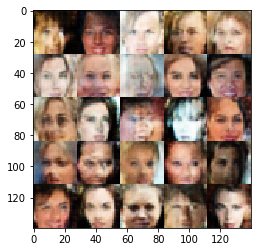

Epoch 1/1... Discriminator Loss: 0.9382... Generator Loss: 1.1729


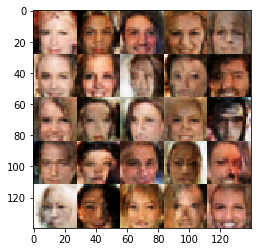

Epoch 1/1... Discriminator Loss: 1.1780... Generator Loss: 0.6208


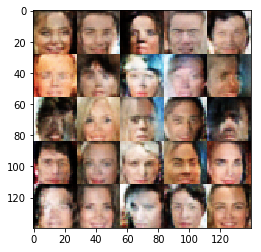

Epoch 1/1... Discriminator Loss: 0.6125... Generator Loss: 2.5978


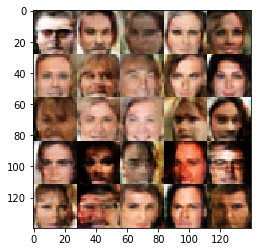

Epoch 1/1... Discriminator Loss: 1.5932... Generator Loss: 1.1433


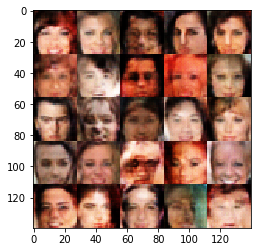

Epoch 1/1... Discriminator Loss: 0.7289... Generator Loss: 1.3158


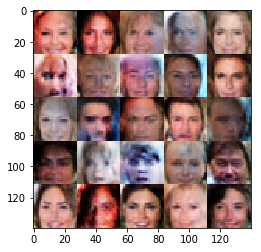

IndexError: list index out of range

In [ ]:
batch_size = 64
z_dim = 100
learning_rate = 0.0002
beta1 = 0.4


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.